# THE PURPOSE OF THIS PYTHON NOTEBOOK

1. See the relationship between noise metrics, and noise metrics and confience


In [1]:
from toolbox.models import ResNet112, ResNet56, ResNet20, ResNetBaby
from toolbox.factor_transfer_components import Paraphraser, Translator
from toolbox.noise_metrics import metrics

import torch
import torchvision
import torchvision.transforms as transforms

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from rich import print as pprint
import os
import glob

device = "cuda"
plt.rcParams["image.cmap"] = "magma"

In [2]:
mean, std = (0.5071, 0.4867, 0.4409), (0.267, 0.256, 0.276)
transform_test = transforms.Compose(
    [
        transforms.ToTensor(),
        transforms.Normalize(mean, std),
    ]
)
testset = torchvision.datasets.CIFAR100(
    root="../data", train=False, download=True, transform=transform_test
)
batch_size = len(testset)
testloader = torch.utils.data.DataLoader(
    testset, batch_size=batch_size, shuffle=True, num_workers=0
)

MODELS = {
    "ResNet112": ResNet112,
    "ResNet56": ResNet56,
    "ResNet20": ResNet20,
    "ResNetBaby": ResNetBaby,
}

all_models = {}

root_dir = "../experiments-24-03"
pth_files = glob.glob(os.path.join(root_dir, "**/Cifar100_ResNet*.pth"), recursive=True)

for file_path in pth_files:
    split = file_path.split("\\")[1:]
    run_number, distillation_type = (
        (split[2], "None") if split[2].isdigit() else (split[3], split[2])
    )
    model_name = split[1].split("_")[0]
    if model_name == "ResNet112" and distillation_type == "None" and run_number == "1":
        model = MODELS[model_name](100).to(device)
        checkpoint = torch.load(file_path, weights_only=True)
        model.load_state_dict(checkpoint["weights"])
        all_models[f"{model_name}_{distillation_type}"] = model
        print(f"Loaded: {model_name}-{distillation_type}")

Files already downloaded and verified
Loaded: ResNet112-None


In [5]:
def get_batch(Model):
    Model.eval()

    with torch.no_grad():
        outputs = Model(inputs)
    probs = torch.nn.functional.softmax(outputs[3], dim=1)
    confidence, predicted = torch.max(probs.data, 1)

    return [
        {
            "feature_map": outputs[2][i],
            "correct": predicted.eq(targets.data).cpu().float()[i].item() == 1.0,
            "predicted_class": np.array(testloader.dataset.classes)[
                predicted.data.cpu()
            ][i],
            "correct_class": np.array(testloader.dataset.classes)[targets.data.cpu()][
                i
            ],
            "confidence": confidence[i].item(),
        }
        for i in range(batch_size)
    ]


inputs, targets = next(iter(testloader))
inputs, targets = inputs.to(device), targets.to(device)

batch = {}
for model in ["ResNet112", "ResNet56", "ResNet20", "ResNetBaby"]:
    for dist_type in ["None", "kd", "ft", "td"]:
        key = f"{model}_{dist_type}"
        if key in all_models:
            batch[key] = get_batch(all_models[key])
            print(f"Added {model}-{dist_type} to active batch")
samples = batch["ResNet112_None"]

Added ResNet112-None to active batch


In [6]:
# from tqdm import trange
# for i in trange(batch_size):
#     fm = samples[i]['feature_map'].unsqueeze(0)
#     samples[i]['metrics'] = {}
#     for key, value in metrics.items():
#         metric = value(fm)
#         samples[i]['metrics'][key] = metric

# sample = {'sample': samples, 'description': 'ResNet112 with no KD'}
# torch.save(sample, 'sample.pt')

loaded_dict = torch.load("sample.pt", weights_only=False)
samples = loaded_dict["sample"]

In [7]:
samples[0]["metrics"]

{'Average': 0.8072096109390259,
 'STD': 1.3045575618743896,
 'Kurtosis': 5.807408051919452,
 'Wavelet High-Frequency Energy': 22.4973935671419,
 'Low-Pass Filter Residuals': 19.33789825439453,
 'Frequency Entropy': 2.095057725906372,
 'IQR': 1.0192979574203491,
 'High-Frequency Power': 102.18726348876953,
 'Coefficient of Variation': 0.6187611818313599,
 'Skewness': 2.3222950097827773,
 'Total Entropy': 7.3221330642700195}

In [8]:
metrics_dict = {'correct': {}, 'incorrect': {}}

for i, key in enumerate(metrics.keys()):
    metrics_correct = []
    metrics_incorrect = []
    for k in range(batch_size):
        if samples[k]['correct']:
            metrics_correct.append(samples[k]['metrics'][key])
        else:
            metrics_incorrect.append(samples[k]['metrics'][key])

    metrics_dict['correct'][key] = np.array(metrics_correct)
    metrics_dict['incorrect'][key] = np.array(metrics_incorrect)
metrics_dict['correct']['confidence'] = np.array([samples[x]['confidence'] for x in range(batch_size) if samples[x]['correct']])
metrics_dict['incorrect']['confidence'] = np.array([samples[x]['confidence'] for x in range(batch_size) if not samples[x]['correct']])

Average Average
Average STD
Average Kurtosis
Average Wavelet High-Frequency Energy
Average Low-Pass Filter Residuals
Average Frequency Entropy
Average IQR
Average High-Frequency Power
Average Coefficient of Variation
Average Skewness
Average Total Entropy
STD Average
STD STD
STD Kurtosis
STD Wavelet High-Frequency Energy
STD Low-Pass Filter Residuals
STD Frequency Entropy
STD IQR
STD High-Frequency Power
STD Coefficient of Variation
STD Skewness
STD Total Entropy
Kurtosis Average
Kurtosis STD
Kurtosis Kurtosis
Kurtosis Wavelet High-Frequency Energy
Kurtosis Low-Pass Filter Residuals
Kurtosis Frequency Entropy
Kurtosis IQR
Kurtosis High-Frequency Power
Kurtosis Coefficient of Variation
Kurtosis Skewness
Kurtosis Total Entropy
Wavelet High-Frequency Energy Average
Wavelet High-Frequency Energy STD
Wavelet High-Frequency Energy Kurtosis
Wavelet High-Frequency Energy Wavelet High-Frequency Energy
Wavelet High-Frequency Energy Low-Pass Filter Residuals
Wavelet High-Frequency Energy Frequenc

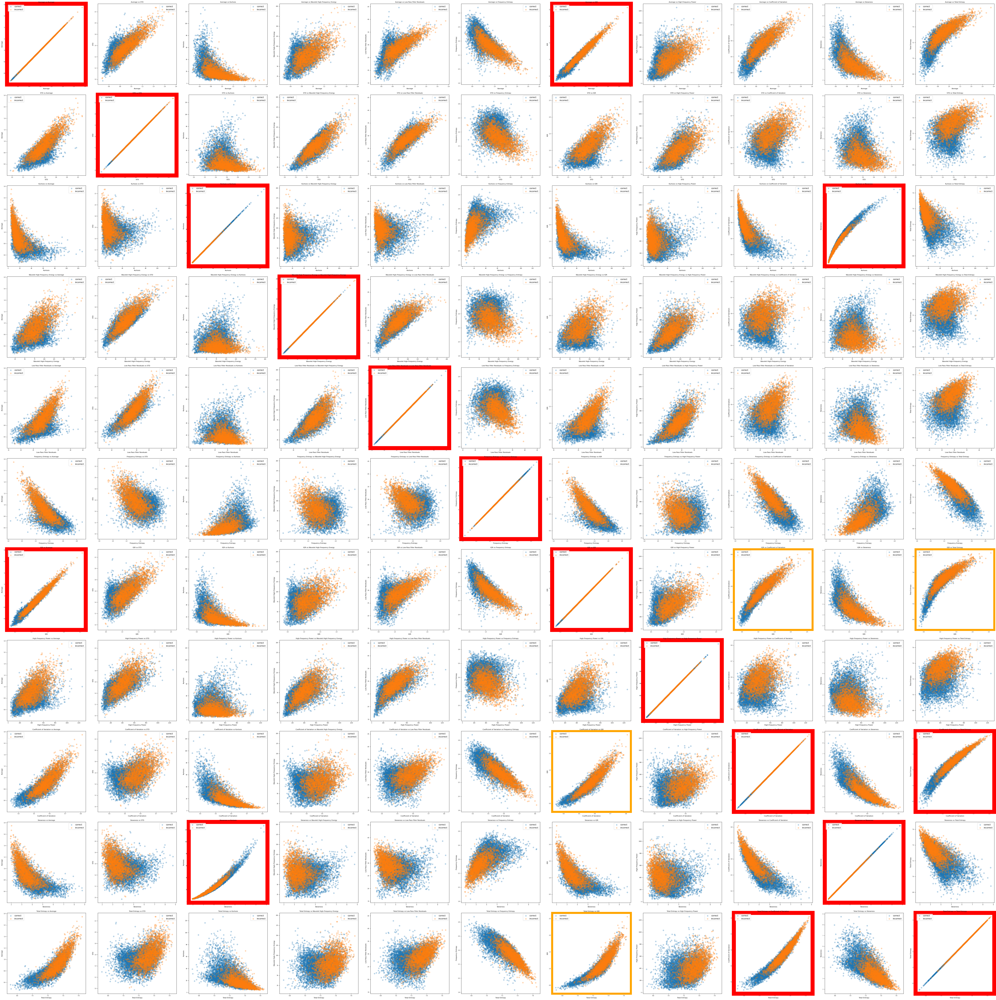

In [18]:
fig, axes = plt.subplots(11, 11, figsize=(70, 70))
fig.tight_layout(pad=3.0)  # Adjust spacing between plots
threshold_1 = 0.85
threshold_2 = 0.95

for i, key1 in enumerate(metrics.keys()):
    for k, key2 in enumerate(metrics.keys()):
        print(key1,key2)
        corr_coef = np.corrcoef(metrics_dict['correct'][key1], metrics_dict['correct'][key2])[0, 1]
        for b in ['correct', 'incorrect']:
            axes[i, k].scatter(metrics_dict[b][key1], metrics_dict[b][key2], alpha=0.3, label=b)
        axes[i, k].set_xlabel(key1, fontsize=8)
        axes[i, k].set_ylabel(key2, fontsize=8)
        axes[i, k].set_title(f"{key1} vs {key2}", fontsize=8)
        axes[i, k].tick_params(axis='x', labelsize=6)  # Smaller x-axis labels
        axes[i, k].tick_params(axis='y', labelsize=6)
        axes[i, k].legend()
        if abs(corr_coef) >= threshold_2:
            for spine in axes[i, k].spines.values():
                spine.set_edgecolor('red')
                spine.set_linewidth(20)  # Makes the border thick and clear
        elif abs(corr_coef) >= threshold_1:
            for spine in axes[i, k].spines.values():
                spine.set_edgecolor('orange')
                spine.set_linewidth(10)  # Makes the border thick and clear
print("Saving figure")
plt.savefig("metric_matrix_plot.png", dpi=300, bbox_inches="tight")
# print("Plotting figure")
# plt.show()
        

In [ ]:
for key in metrics.keys():
    for b in ['correct', 'incorrect']:
        plt.scatter(metrics_dict[b]['confidence'],metrics_dict[b][key], label=b, alpha=0.3)
    plt.ylabel(key)
    plt.xlabel('confidence')
    plt.legend()
    plt.show()

    plt.boxplot([metrics_dict['correct'][key], metrics_dict['incorrect'][key]],
            vert=True,         # Vertical boxes
            patch_artist=True, # Fill boxes with color
            showmeans=True,    # Show the mean as a point
            meanline=False,    # Use a point instead of a line for mean
            meanprops={'marker': 'o', 'markerfacecolor': 'red', 'markeredgecolor': 'black'})
    plt.xticks([1, 2], ['Correct', 'Incorrect'])
    plt.ylabel(key)
    plt.show()
    print('='*200)



Doing things for entropy
Pearson Correlation Coefficient for entropy - correct: -0.397
Pearson Correlation Coefficient for entropy - incorrect: -0.373


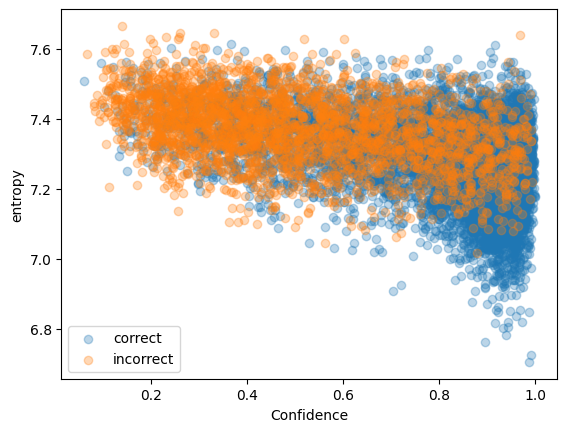

Doing things for cv
Pearson Correlation Coefficient for cv - correct: -0.406
Pearson Correlation Coefficient for cv - incorrect: -0.380


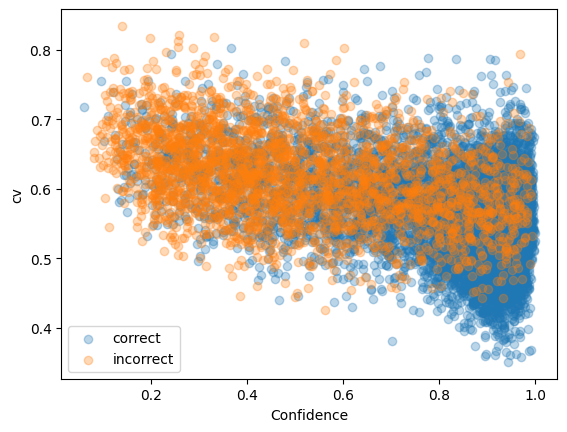

Pearson Correlation Coefficient for correct: 0.955
Pearson Correlation Coefficient for incorrect: 0.966


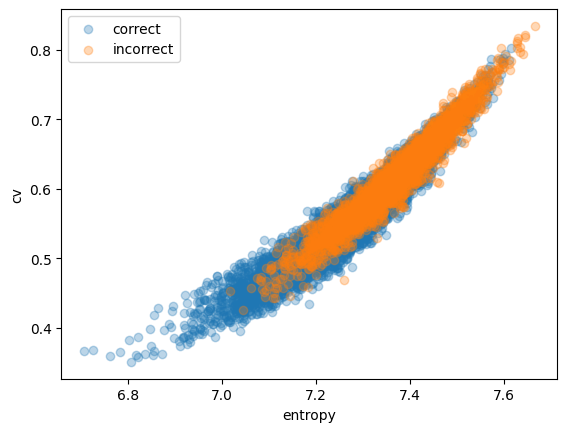

In [ ]:
for key in ["ResNet56_None"]:
    confs, entrops, cvs = [[], []], [[], []], [[], []]
    for i in range(batch_size):
        current = batch[key][i]
        index = 0 if current["correct"] else 1
        confs[index].append(current["confidence"])
        entrops[index].append(current["entropy"][2])
        cvs[index].append(current["cv"][2])

    things = ["entropy", "cv"]
    for i, thing in enumerate([entrops, cvs]):
        print(f"Doing things for {things[i]}")
        for num in [0, 1]:
            pred = "correct" if num == 0 else "incorrect"
            plt.scatter(confs[num], thing[num], alpha=0.3, label=pred)
            correlation = np.corrcoef(confs[num], thing[num])[0, 1]
            print(
                f"Pearson Correlation Coefficient for {things[i]} - {pred}: {correlation:.3f}"
            )
        plt.xlabel("Confidence")
        plt.ylabel(things[i])
        plt.legend()
        plt.show()

    for num in [0, 1]:
        pred = "correct" if num == 0 else "incorrect"
        plt.scatter(entrops[num], cvs[num], alpha=0.3, label=pred)
        correlation = np.corrcoef(entrops[num], cvs[num])[0, 1]
        print(f"Pearson Correlation Coefficient for {pred}: {correlation:.3f}")

    plt.xlabel("entropy")
    plt.ylabel("cv")
    plt.legend()
    plt.show()

    break